<a href="https://colab.research.google.com/github/2002sahapriya/HDR-Imaging/blob/master/%5BCS_484%5D_Final_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## CS 484 - Final Project (Project 3)

# Enchancing Photographic Realism: HDR Imaging via Debevec-Malik Method & Beyond

#### Submission by: Priyadarshini Saha
#### UW Email: p24saha@uwaterloo.ca
#### Date: April 25, 2024

# 1.0 Abstract

# 2.0 Background Study

## 2.1 Understanding HDR Imaging

### 2.1.1 What is Dynamic Range?
Dynamic range in photography and imaging refers to the range of luminance between the darkest and brightest parts of a scene that a camera can capture or a display can show. It is cricual for capturing images that are true to the scene's real-world appearance, without losing details in shadows or highlights.
#### Mathematical Explanation
The dynamic range is typically expressed in **stops** or **exposure values**, with each stop representing a doubling of light intensity. Mathematically, if the darkest light intensity a camera can capture is $L_{min}$ and the brightest is $L_{max}$, the dynamic range $DR$ in stops can be calculated as:
$$ DR = log_2\left(\frac{L_{max}}{L_{min}}\right) = \text{Highest EV - Lowest EV}$$  

### 2.1.2 Why do we need HDR Imaging?
HDR imaging is needed to overcome the limitations of standard digital cameras that cannot capture the full luminance range of real-world scenes in a single photograph. Scenes that include bright daylight and deep shadows often result in images where one or both extremes lose detail—shadows may turn into undifferentiated black areas, and highlights may become washed out white spots. HDR imaging allows for capturing and displaying more natural and detailed scenes as perceived by the human eye. The human eye can percieve a much wider range of light intensities than cameras can capture in a single exposure. HDR techniques help bridge this gap by combining multiple exposures into one image, preserving details in both very bright and very darl areas.

#### Mathematical Explanation
Consider a scene with a luminance range that a camera captures over three exposures at different exposure times $t_1, t_2, t_3$. Assuming a linear camera response, the captured image intensities for a scene radiance $R$ would vary with exposure time as:
$$ I_1 = R \cdot t_1, I_2 = R \cdot t_2, I_3 = R \cdot t_3 $$
HDR imaging combines these to reconstruct the real scene radiance $R$ across its full luminance range.


### 2.1.3 What is HDR Imaging?
HDR imaging is the process of taking multiple images at different exposures to capture the full brightness range of a scene and then combining these images into a single photo that shows more detail than could be captured in a single exposure.

#### Mathematical Explanation:
If $I(x, y)$ represents the pixel intensities for images at different exposures and $CRF^{-1}$ is the inverse of the camera response function, then the HDR image is obtained by:

$$ HDR(x, y) = \frac{\sum^n_{i=1} w(I_i(x, y) \cdot CRF^{-1}(I_i(x, y))}{\sum^n_{i=1}w(I_i(x, y))} $$

### 2.1.4 How does HDR Imaging work ?
HDR imaging typically involves capturing several shots of the same scene at different exposure settings (a process called bracketing) to cover all parts of the scene's lunimance range. These images are then merged into a single image using specialized software or techniques that calculates a more accurare depiction of the scene's real luminance values. The software calculates the best representation of each pixel based on its appearance in underexposed, correctly exposed, and overexposed images, resulting in an image with a higher dynamic range. The final HDR image retains the detailed highlights and shadows that would be lost in a single exposure.

#### Mathematical Explanation:
Using the camera response function $CRF$, the method involves solving for the radiance map $R(x, y)$ that minimizes the error across all exposures:
$$ min \sum^n_{i=1}(CRF(R(x, y) \cdot t_i)) - I_i(x, y))^2 + \lambda \cdot Smoothness(R)$$ where $\lambda$ controls the smoothness regularization.

### 2.1.5 Challenges in HDR Imaging?
- Ghosting: Movement between frames when capturing multiple exposures can lead to ghosting artifacts in the final HDR image.
- Misalignment: If the camera moves between shots, alignment issues can occur, requiring complex image registration techniques.
- Tone Mapping: Converting HDR images for display on standard dynamic range devices requires tone mapping, which can be challenging to achieve without losing important scene details or creating unrealistic effects.
- Camera and Scene Limitations: Not all scenes and cameras are suited for HDR due to extreme contrast or inadequate sensor performance.

#### Motivation: How does the Debevec-Malik method help ?
The Debevec-Malik method addresses several of these challenges by providing a robust mathematical model to reconstruct the camera's response function from multiple exposures. This allows accurate merging of the exposures into a single HDR image. By calculating the true radiance values of the scene, it effectively combines images taken at different exposure levels to produce a high-quality HDR image without losing details. This method also provides a foundation for more advanced HDR techniques, including those that handle movement and camera shake, through the use of image alignment and ghost removal technologies.

The Debevec-Malik method precisely reconstructs the camera response function from multiple exposures, enabling accurate merging of these exposures into a single HDR image. This method effectively extends the captured dynamic range and improves image realism.

#### Mathematical Explanation:
The method employs a least square solution to recover the camera response function $CRF$ and the radiance values $R$:
$$ min_{CRF, R} \sum^n_{i=1}(CRF(R \cdot t_i)) - I_i)^2 + \lambda \cdot Smoothness(R)$$
This approach not only estimates $R$ but also derives a function $CRF$ that is crucial for accurate HDR rendering.

## 2.2 Debevec-Malik Method
### 2.2.1 Overview of the Debevec-Malik Method
The Debevec-Malik method is a technique developed for high-dynamic range (HDR) imaging, which allows for the capture and display of a broader range of luminance levels than typical digital imaging techniques. The method was introduced by Paul Debevec and Jitendra Malik in 1997 and is based on constructing an HDR image by combining multiple low-dynamic range (LDR) images taken at different exposure levels.

### 2.2.2 Explanation of the Debevec-Malik Method
The Debevec-Malik method operates by first determining the camera's response function to light, which is necessary to understand how different exposures relate to the actual scene luminance. With this function, the method uses multiple differently exposed images of a static scene to recover the radiance map of the scene, essentially reconstructing what each pixel's true luminance is.

### 2.2.3 Algorithm for the Debevec-Malik Method
Below is a high-level algorithm representation of the method:
1. **Capture a sequence of images** at different exposure settings
2. **Select a set of pixel locations** across the images for sampling
3. **Solve for the camera response function (CRF)** using the selected pixels and their known exposure times
4. **Reconstruct the HDR radiance map** of the scene using the CRF
5. **Generate the final HDR image by** combining the radiance map with tone mapping to display on standard devices.


#### Summary of key steps & principles involved:
1. **Capturing Multiple Exposures**
The process begins with capturing a series of photographs of the same scene at different exposure settings. Typically, these exposures vary the shutter speed while keeping the aperture constant to maintain depth of field consistency. This sequence captures varying amounts of light, from shadows to highlights, that no single exposure could capture entirely.
2. **Camera Response Function (CRF)**
The method requires knowledge of the camera's response function, which describes how the camera converts incoming light into digital values. Debevec and Malik proposed a method to recover this function by observing how pixel values change with varying exposure levels.
3. **Solving for the Response Curve**
To reconstruct the camera response curve, the algorithm uses the set of differently exposed images and solves a system of equations that relates the known exposures with the pixel intensities observed in the images. This involves minimizing the discrepancy between the radiance values that would lead to the observed pixel values in all the photographs. A regularization term is often added to ensure smoothness in the response curve.
4. **Constructing the Radiance Map**
Once the response curve is known, it can be used to convert the set of images into a single radiance map. This map represents the true luminance of each pixel in the scene, combining information from all exposures. Each pixel's radiance is calculated by appropriately weighting its value in each exposure, using the inverse of the response function.
5. **Generating the HDR Image**
The radiance map, which contains high dynamic range information, is converted into an HDR image. This image can capture details in both the brightest and darkest areas of the scene, which are usually lost in standard photographs due to over- and under-exposure.
6. **Tone Mapping for Display**
Because HDR images contain a range of luminance that exceeds what typical displays can render, a tone mapping step is necessary. Tone mapping reduces the dynamic range of the HDR image to make it suitable for display on standard monitors while preserving important details and contrast.

The Debevec-Malik method is highly valued for its ability to produce photorealistic images and is widely used in photographic and visual effects industries where accurate reproduction of lighting is crucial.

# 3.0 Project Overview

## 3.1 Objectives

## 3.2 Approach

## 3.3 Scope & Limitations

# 4.0 Code Libraries

Here is the list of libraries used for this project and their purpose:
1. OpenCV (`cv2`)
2. NumPy (`numpy`)
3. `os` (standard library)
4. Python Imaging Library (Pillow, imported as Image `PIL`)
5. exifread
6. Matplotlib (`pyplot`)
7. `scipy.optimize` (least_sqaures)
8. `random`

# 5.0 Setup

In [ ]:
!pip install opencv-python numpy pillow exifread

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 35.4/35.4 MB 14.2 MB/s eta 0:00:0000:0100:01
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.4/40.4 kB 2.8 MB/s eta 0:00:00


In [ ]:
import os
from PIL import Image
import exifread
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
from scipy.optimize import least_squares
import random

# 6.0 Data Preparation
- Load Brackedted images (taken with a tripod so images are already aligned)
- Extract exposure times from the images
- Align images

In [ ]:
# Function to load bracketed images
def load_bracketed_images(directory):
    """
    Load all images in the given directory, assuming they are part of a bracketed set.
    """
    images = []
    image_files = [f for f in os.listdir(directory) if f.endswith(('.png', '.jpg', '.jpeg'))]
    for file in sorted(image_files):
        # Read the image
        img = cv2.imread(os.path.join(directory, file))
        # Convert image to RGB
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        images.append(img)
    return images

In [ ]:
# Function to extract exposure times from images and load images by
def extract_exposure_times(directory):
    """
    Extract exposure times from the images' EXIF data.
    """
    exposure_times = []
    image_files = [f for f in os.listdir(directory) if f.endswith(('.png', '.jpg', '.jpeg'))]
    for file in sorted(image_files):
        with open(os.path.join(directory, file), 'rb') as f:
            tags = exifread.process_file(f)
            # Access the 'EXIF ExposureTime' tag
            exposure_time = tags.get('EXIF ExposureTime')
            if exposure_time:  # Ensure the tag exists
                # Convert the exposure time to a string and then to a float
                exposure_time_str = str(exposure_time)
                # Split the fraction string into numerator and denominator
                numerator, denominator = exposure_time_str.split('/')
                exposure_sec = float(numerator) / float(denominator)
                exposure_times.append(exposure_sec)
            else:
                print(f"Exposure time not found in {file}.")
    return exposure_times

In [ ]:
# Function extract images by channel
def extract_channels(images):
    """
    Extracts the blue, green, and red channels from a list of RGB images.

    Parameters:
    - images: list of numpy.ndarray, where each ndarray is an RGB image.

    Returns:
    - Tuple of three lists: (blue_channels, green_channels, red_channels),
      where each list contains the respective channel images of all input images.
    """
    blue_channels = []
    green_channels = []
    red_channels = []

    for img in images:
        # Split the image into its three channels
        blue, green, red = cv2.split(img)

        # Append each channel to its respective list
        blue_channels.append(blue)
        green_channels.append(green)
        red_channels.append(red)

    return blue_channels, green_channels, red_channels

In [ ]:
# Function to align images
def align_images(images):
    """
    Align images using ECC algorithm in OpenCV.
    """
    # Convert all images to grayscale for alignment
    gray_images = [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) for img in images]
    aligned_images = [images[0]]  # Initialize with the reference image

    # Warp each image to the reference image
    for img in gray_images[1:]:
        warp_matrix = np.eye(2, 3, dtype=np.float32)
        criteria = (cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_COUNT, 5000, 1e-10)
        (_, warp_matrix) = cv2.findTransformECC(gray_images[0], img, warp_matrix, cv2.MOTION_AFFINE, criteria)
        aligned_img = cv2.warpAffine(img, warp_matrix, (img.shape[1], img.shape[0]), flags=cv2.INTER_LINEAR + cv2.WARP_INVERSE_MAP)
        aligned_images.append(aligned_img)
    return aligned_images

In [ ]:
# Function to display an image
def display_images(images, titles=None, cols=3, cmap=None):
    """
    Display a list of images in a grid.

    Args:
    - images (list of ndarray): List of images to display.
    - titles (list of str): Optional list of titles for each image.
    - cols (int): Number of columns in the display grid.
    - cmap (str): Colormap used for displaying grayscale images.
    """
    n_images = len(images)
    rows = n_images // cols + int(n_images % cols != 0)
    fig = plt.figure(figsize=(15, rows * 5))

    for i in range(1, n_images + 1):
        ax = fig.add_subplot(rows, cols, i)
        ax.imshow(cv2.cvtColor(images[i-1], cv2.COLOR_BGR2RGB), cmap=cmap)
        ax.axis('off')
        if titles and i <= len(titles):
            ax.set_title(f'Exposure Time: {titles[i-1]} secs')
    plt.tight_layout()
    plt.show()

In [ ]:
directory = 'datasets/images1'  # Set directory path
# Load the images from the dataset
bracketed_images = load_bracketed_images(directory)
# Extract the exposure times for the images
exposure_times = extract_exposure_times(directory)
# Extract the BGR channels for the images
blue_channels, green_channels, red_channels = extract_channels(bracketed_images)

In [ ]:
print("Exposure times:", exposure_times)

Exposure times: [0.0008, 0.001, 0.00125, 0.0015625, 0.002, 0.0025, 0.003125, 0.005, 0.00625, 0.008, 0.01, 0.0125, 0.016666666666666666, 0.02, 0.025, 0.03333333333333333, 0.04, 0.05, 0.06666666666666667, 0.07692307692307693, 0.1, 0.125, 0.16666666666666666, 0.2, 0.25, 0.3, 0.4, 0.5]


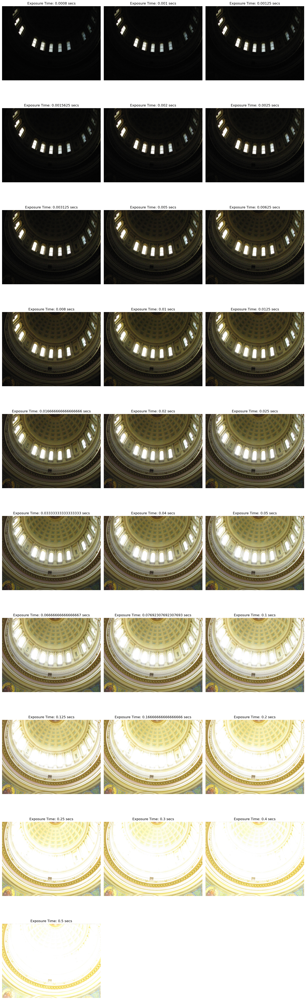

Display bracketed images: None


In [ ]:
print("Display bracketed images:", display_images(bracketed_images, exposure_times))

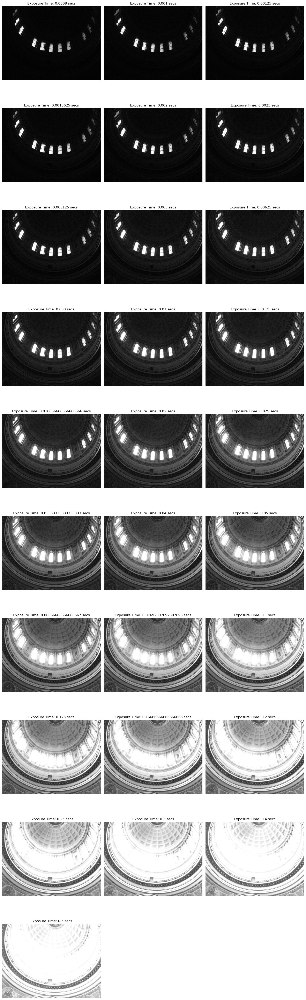

Display Red channel images: None


In [ ]:
print("Display Red channel images:", display_images(red_channels, exposure_times))

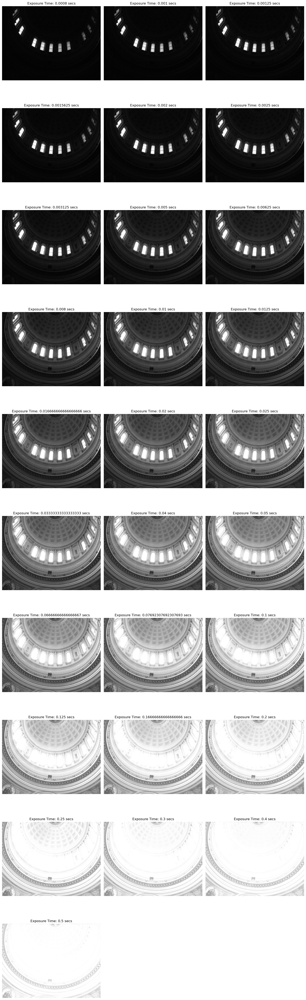

Display Green channel images: None


In [ ]:
print("Display Green channel images:", display_images(green_channels, exposure_times))

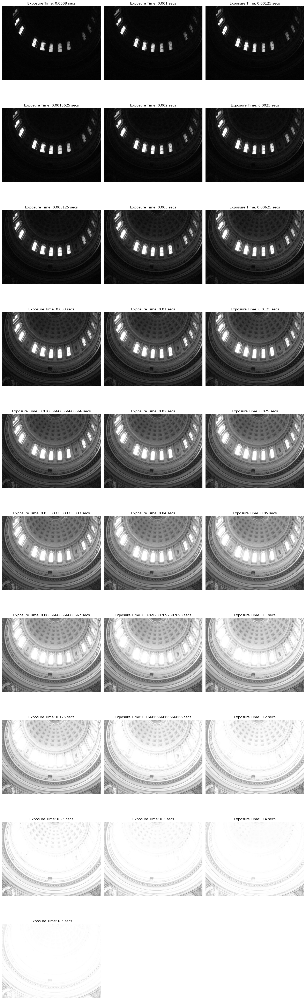

Display Blue channel images: None


In [ ]:
print("Display Blue channel images:", display_images(blue_channels, exposure_times))

# 7.0 Core Implementation
- Camera Response Function (CRF) Estimation: Implement or use an existing function to estimate the CRF.
- Image Alignment (if needed): Demonstrate the method used for aligning images without a tripod.
- Radiance Map Construction: Construct the radiance map using the CRF and aligned images.
- Create HDR Image: Merge the images into an HDR image using the radiance map.
- Tone Mapping: Apply tone mapping to convert the HDR image for display on standard dynamic range (SDR) devices.

## 7.1 Step 1: Calculation / Estimating the Camera Response Function (Radometric Response Function)
Calculating the Camera Response Function (CRF) involves solving for a function that maps the known exposure values and the observed pixel values to the actual scene radiance. The objective is to determine how the camera's sensor responds to different levels of light intensity, which is necessary for combining multiple exposures into a single HDR image.

### Mathematical Explanation:
- Let $z_{ij}$ be the pixel value of i-th pixel in the j-th image
- $E_i$ is the radiance of the i-th pixel in the scene
- $t_j$ is the exposure time for the j-th image
- The CRF $g$ maps the pixel value to the log radiance

**Goal**: Find the function $g$ such that $g(z_{ij}) = log(E_i) + log(t_j)$. This is typically done by setting up a system of equations for all pixels and solving it, often using a least squares method to minimize the different between both sides of the equation for all $i$ and $j$.

**Solving the Equation:**
A regularization term is often added to ensure smoothness in the function $g$. The overall optimization problem might look something like:

$$ min_{g, E} \left(\sum_{i, j}w(z_{ij}) \left(g(z_{ij}) - log(E_i) - log(t_j)\right)^2 + \lambda\sum_z(g'(z))^2\right)$$

where $w(z)$ is a weighting function that gives less emphasis to pixel values that are near saturation or underexposed, and $\lambda$ is a regularization parameter controlling the smoothness of $g$.

This system is usually underdetermined, meaning there are more unknowns than equations, so constraints are added to make the problem solvable. One common constraint fixes the middle value of the response curve to zero to remove an inherent ambiguity in the solution.

### Code Implementation:
1. Select pixels for sampling: Choose a representative subset of pixel values from the images to avoid processing every single pixel.
2. Define the weight function: The given weight is given as -
$$  $$
3. Set up the System of Equations: Create a system based on the relationship between pixel values, exposure times, and scene radiance.
4. Solve the System: Use numerical optimization to solve for the camera response function.
5. Plot the pixel value vs. log exposure curver for each channel (RGB)

In [ ]:
# Weighting function
def weights(z):
    """
    Define the weighting function for each pixel.
    """
    z_min, z_max = 0., 255.
    if z <= (z_min + z_max) / 2:
        return z - z_min
    return z_max - z

In [ ]:
# Helper: Function to select pixels for sampling
def select_random_pixels(num_pixels, num_samples):
    # Randomly select 'num_samples' unique pixel indices from 'num_pixels' total pixels
    return random.sample(range(num_pixels), num_samples)

# Helper: Plot the pixel samples
def plot_pixel_samples(image, pixel_indices, save_name):
    # Plot an image with red dots at the locations of 'pixel_indices'
    # Convert list to numpy array for element-wise operations
    pixel_indices = np.array(pixel_indices)

    x = pixel_indices % image.shape[1] # Calculate the x-coordinates
    y =  pixel_indices // image.shape[1] # Calculate the y-coordinates
    plt.figure()
    plt.imshow(image, cmap='gray')
    plt.scatter(x, y, c='r')
    plt.title('Samples')
    plt.axis('off')
    plt.savefig(f'{save_name}.png')
    plt.show()

# Function to get the pixel samples
def get_pixel_samples(image, save_name='Results\samples', num_samples=100, save_samples=True):
    # Get 'num_samples' random pixel indices from 'image' and optionally plot the sample locations
    pixel_indices = select_random_pixels(image.size, num_samples)
    if save_samples:
        plot_pixel_samples(image, pixel_indices, save_name)
    return pixel_indices

def get_pixel_values_from_indices(images, indices):
    # Retrieve pixel values from 'images' at the locations specified by 'indices'
    # The list comprehension traverses each image and collects values from the flattened image array
    return [[img.ravel()[index] for index in indices] for img in images]

In [ ]:
# Function to construct the system of equations
def construct_system(pixel_samples, log_exposure_times, smoothing_lambda):
    """
    Construct the system of equations derived from the CRF model.
    """
    num_samples = pixel_samples.shape[0]
    num_images = pixel_samples.shape[1]
    num_pixels = num_samples * num_images
    num_equations = num_pixels + 255  # 256 intensities - 1
    A = np.zeros((num_equations, num_pixels + 256))  # 256 for the g function values
    b = np.zeros(num_equations)

    # Add data-fitting equations
    k = 0
    for i in range(num_samples):
        for j in range(num_images):
            wij = weighting_function(pixel_samples[i, j])
            z = int(pixel_samples[i, j])  # Ensure this is an integer for indexing
            A[k, i * num_images + j] = wij
            A[k, num_pixels + z] = -wij  # Ensure z is used as an index
            b[k] = wij * log_exposure_times[j]
            k += 1


    # Add smoothing equations
    for z in range(254):  # Exclude the first and last intensity value
        A[k, num_pixels + z] = smoothing_lambda * weighting_function(z + 1)
        A[k, num_pixels + z + 1] = -2 * smoothing_lambda * weighting_function(z + 1)
        A[k, num_pixels + z + 2] = smoothing_lambda * weighting_function(z + 1)
        k += 1

    # Fix the curve by setting its middle value to 0
    A[k, num_pixels + 128] = 1

    return A, b

In [ ]:
# Function to calculate the camera response function/ curve
def compute_response_curve(pixel_values, log_exposures, lambda_smoothing=100):
    """
    Computes the camera response curve using a system of linear equations that incorporate data fitting and smoothness.

    Parameters:
    - pixel_values (numpy.ndarray): 2D array of pixel intensities across different exposures.
    - log_exposures (numpy.array): Array of logarithmic exposure times.
    - weights (numpy.array): Weight function values for each pixel intensity.
    - lambda_smoothing (float): Regularization parameter for smoothness.

    Returns:
    - numpy.array: The estimated camera response curve.
    """
    pixel_values = np.array(pixel_values)  # Convert list to numpy array if not already
    log_exposures = np.array(log_exposures)  # Ensure log_exposures is also an array

    max_pixel_value = 256
    num_images = pixel_values.shape[0] # number of images
    num_samples = pixel_values.shape[1] # number of samples

    # Initialize the system matrix A and vector b
    A = np.zeros((num_samples * num_images + max_pixel_value + 1, max_pixel_value + num_samples), dtype=np.float32)
    b = np.zeros((A.shape[0], 1), dtype=np.float32)

    # Build the data-fitting term
    k = 0
    for sample in range(num_samples):
        for image in range(num_images):
            pixel = pixel_values[image][sample]
            weight = weights(pixel)
            A[k][pixel] = weight
            A[k][max_pixel_value + sample] = -weight
            b[k] = weight * log_exposures[image]
            k += 1

    # Center the curve - fix the curve by setting its middle value to 0 (middle = 256/2)
    A[k][128] = 1
    k += 1

    # Adding smoothness constraints
    for i in range(max_pixel_value - 1):
        A[k][i] = lambda_smoothing * weights(i + 1)
        A[k][i + 1] = -2 * lambda_smoothing * weights(i + 1)
        A[k][i + 2] = lambda_smoothing * weights(i + 1)
        k += 1

    # Solve the system to find the CRF
    solution = np.linalg.lstsq(A, b, rcond=None)[0]
    response_curve = solution[:max_pixel_value]
    radiance = solution[max_pixel_value:np.size(solution, 0)]

    return response_curve, radiance

In [ ]:
# Plot the response curves
def plot_response_curves(blue_curve, green_curve, red_curve):
    """
    Plots the camera response curves for the blue, green, and red channels individually and together in a grid layout.

    Parameters:
    - blue_curve (numpy.array): Camera response curve for the blue channel.
    - green_curve (numpy.array): Camera response curve for the green channel.
    - red_curve (numpy.array): Camera response curve for the red channel.
    """
    # Create a grid layout
    gs = gridspec.GridSpec(3, 2, width_ratios=[1,2], height_ratios=[3, 3, 3])

    plt.figure(figsize=(12, 8))

    ax0 = plt.subplot(gs[0, 0])
    ax0.plot(blue_curve, np.arange(256), 'b')
    ax0.set_xlabel('Log Exposure X')
    ax0.set_ylabel('Pixel Value Z')
    ax0.set_title('Blue Channel')
    ax0.grid(True)

    ax1 = plt.subplot(gs[1, 0])
    ax1.set_xlabel('Log Exposure X')
    ax1.set_ylabel('Pixel Value Z')
    ax1.plot(green_curve, np.arange(256), 'g')
    ax1.set_title('Green Channel')
    ax1.grid(True)

    ax2 = plt.subplot(gs[2, 0])
    ax2.plot(red_curve, np.arange(256), 'r')
    ax2.set_xlabel('Log Exposure X')
    ax2.set_ylabel('Pixel Value Z')
    ax2.set_title('Red Channel')
    ax2.grid(True)

    # Larger subplot for combined curves
    ax3 = plt.subplot(gs[0:3, 1])
    ax3.plot(blue_curve, np.arange(256), 'b', label='Blue')
    ax3.plot(green_curve,np.arange(256),  'g', label='Green')
    ax3.plot(red_curve, np.arange(256), 'r', label='Red')
    ax3.set_xlabel('Log Exposure X')
    ax3.set_ylabel('Pixel Value Z')
    ax3.set_title('Combined Response Curves')
    ax3.legend()
    ax3.grid(True)

    # Adjust layout for spacing
    plt.tight_layout()
    plt.show()
    plt.savefig('Results\response_curves.png')

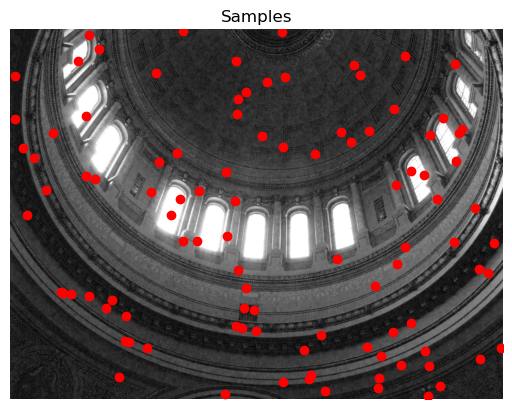

In [ ]:
# Log exposure times
log_exposure_times = np.log(exposure_times)
# smoothing constant
smooth_lambda = 100

# Generate samples and get pixel values
# Image to sample
sample_image = red_channels[len(red_channels) // 2]
# Generate random samples with num_samples = 100
samples = get_pixel_samples(sample_image, save_name='Results\samples')
# Channel sample pixel values with dimensions (num_samples, num_images)
pixels_blue = get_pixel_values_from_indices(blue_channels, samples) # for blue
pixels_green = get_pixel_values_from_indices(green_channels, samples) # for green
pixels_red = get_pixel_values_from_indices(red_channels, samples) # for red

# Reconstruct response curves
blue_response_curve, blue_radiance = compute_response_curve(pixels_blue, log_exposure_times, smooth_lambda) # for blue
green_response_curve, green_radiance = compute_response_curve(pixels_green, log_exposure_times, smooth_lambda) # for green
red_response_curve, red_radiance = compute_response_curve(pixels_red, log_exposure_times, smooth_lambda) # for red

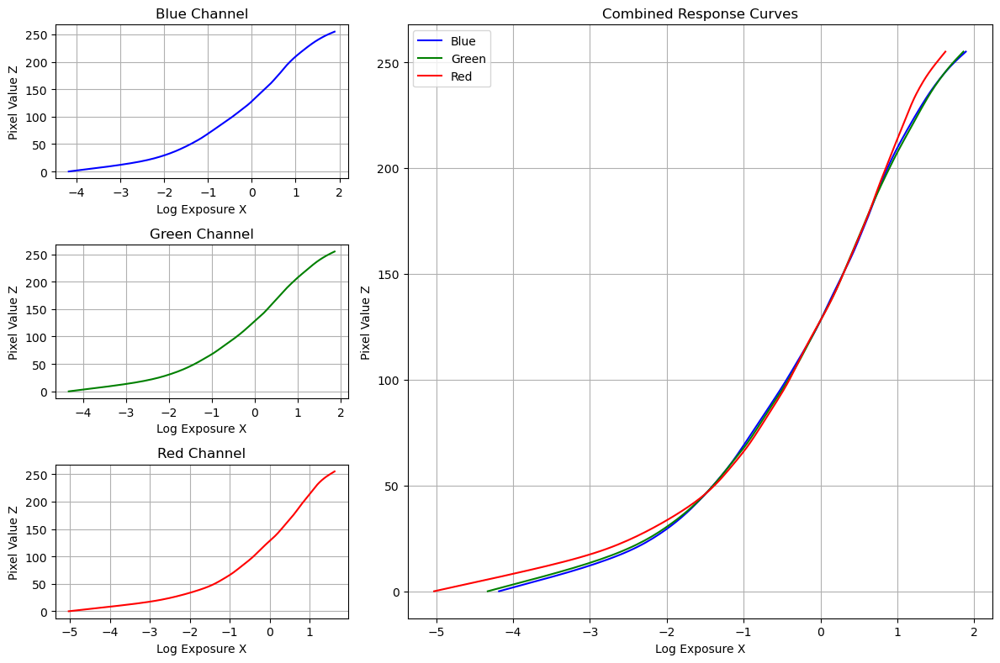

<Figure size 640x480 with 0 Axes>

In [ ]:
# Now plot the response curves for all channels
plot_response_curves(blue_response_curve, green_response_curve, red_response_curve)

### 7.2 Step 2: Computing the Radiance Map

# 8.0 Enchancements
## 8.1 Advances Alignment Techniques:
- Explore sophisticated image registration techniques, possibly integrating ML approaches.
- Implement homography-based registration to align images taken without a tripod. This may involve feature detection, matching, and image warping.
- Explore techniques like feature-based alignment using SIFT or SURF for robust registration.

## 8.2 Handling Unknown Exposures:
- Discuss and implement methods for estimating unknown exposure times
- You might integrate scene analysis to estimate relative exposures or use machine learning techniques to predict exposure settings.

# 9.0 Advanced Implementations (Code)

# 10.0 Testing & Validation
- With Tripod: Test your HDR image creation on the bracketed image sequences taken with a tripod. Validate the quality and effectiveness of the HDR images.
- Without Tripod: Test the extended method on multi-exposure images taken without a tripod. Assess how well your homography registration and automatic exposure estimation work in practical scenarios.

# 11.0 Analysis & Optimizations
- Performance Analysis: Evaluate the performance of your algorithm in terms of speed, accuracy, and robustness. Analyze how different conditions affect the outcomes (e.g., light levels, motion blur).
- Optimization: Identify any bottlenecks and optimize the code. This could involve improving the algorithm efficiency, refining image registration, or better handling of edge cases.

# 12.0 Results

## 12.1 Analysis of Results
## 12.2 Quality Assessment

# 13.0 Discussions

## 13.1 Summary of Results
## 13.2 Important Results
## 13.3 Challengs Encountered
## 13.4 Future Work

# 14.0 Conclusion

## 14.1 Summary of results
## 14.2 Achievements
## 14.3 Impact of Understandinf

# 15.0 References

# 16.0 Appendix